# Data augmentation

So far in this project we are working with 
the siamese neural netork, we were given a set of videos 
from pronatura. 
we extract the frames from each in all the videos 
and we run the CLIP model from OpenAI to predict
the images that contain a jaguar in them. 




In [1]:
import pandas as pd 


In [3]:
df = pd.read_csv("img_sim.csv")
df.head()

,Unnamed: 0,Unnamed: 0.1,img,video,xmax,ymax,xmin,ymin,label,similarity,indv
0,45,45,frames/frames1/30.jpg,frames1,508,432,123,136,Jaguar,28.834324,frames1
1,92,92,frames/frames2/60.jpg,frames2,445,357,236,190,not_jaguar,26.585011,frames2
2,103,103,frames/frames2/90.jpg,frames2,459,350,231,180,not_jaguar,27.067038,frames2
3,127,127,frames/frames4/0.jpg,frames4,944,360,488,114,Jaguar,29.088072,frames4
4,134,134,frames/frames4/30.jpg,frames4,759,392,509,195,not_jaguar,27.595686,frames4


In [26]:
## we have 34 videos of jaguars we supose that 
# that the jaguars in all the videos are different 
#So, we say that we have 34 different jaguars. 
len(df["indv"].unique())

34

In [ ]:
df.groupby("indv",sort=False).count()["similarity"]

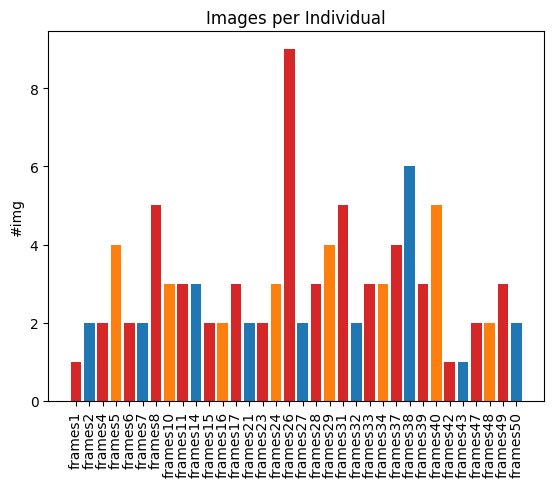

In [247]:
import matplotlib.pyplot as plt
#we want to plot the number of images we have per individual. 

fig, ax = plt.subplots()

#fruits = ['apple', 'blueberry', 'cherry', 'orange']
#counts = [40, 100, 30, 55]
#bar_labels = ['red', 'blue', '_red', 'orange']
#bar_colors = ['tab:red', 'tab:blue', 'tab:red', 'tab:orange']
fruits =list(df["indv"].unique())
counts = list(df.groupby("indv",sort=False).count()["similarity"])


ax.bar(fruits, counts, label=bar_labels, color=bar_colors)

ax.set_ylabel('#img')
ax.set_title('Images per Individual')
#ax.legend(title='Fruit color')
plt.xticks(rotation = 90) #
plt.show()

## Lack of images 
As you can see in the graph above, we do not have to much images of each jaguar. the maximum number of images per individual. 


We are going to use a random flip technique to obtain 
nine image from a single image 
we will get some inbalanced classes however, we can make another process of data augmentation. 

In [28]:
len(df)*9

909

In [ ]:
#exploring the 
!pip install rembg

In [32]:
list(df.query("indv=='frames8'")["img"])[0]

'frames/frames8/120.jpg'

Text(0.5, 1.0, 'Second')

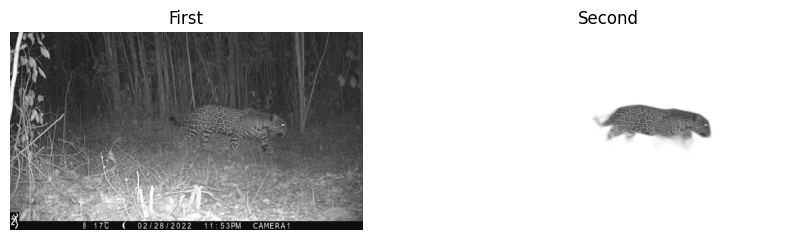

In [39]:
# Adds a subplot at the 1st position

rows = 2
columns = 2

fig = plt.figure(figsize=(10, 7))



input_path = list(df.query("indv=='frames8'")["img"])[0]

img  = Image.open(input_path)
output = remove(img)


fig.add_subplot(rows, columns, 1)
# showing image
plt.imshow(img)
plt.axis('off')
plt.title("First")
  
# Adds a subplot at the 2nd position
fig.add_subplot(rows, columns, 2)
# showing image
plt.imshow(output)
plt.axis('off')
plt.title("Second")


In [40]:
list(df.query("indv=='frames8'")["img"])[0]

'frames/frames8/120.jpg'

In [48]:
list(df.query("indv=='frames8'")["img"])[0].replace("frames/","").replace("/","_")

'frames8_120.jpg'

frames/frames8/120.jpg
frames/frames8/150.jpg
frames/frames8/30.jpg
frames/frames8/60.jpg
frames/frames8/90.jpg


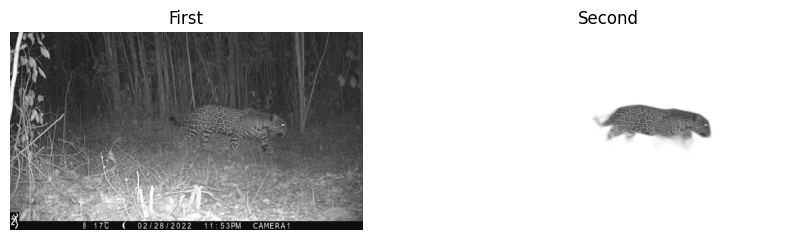

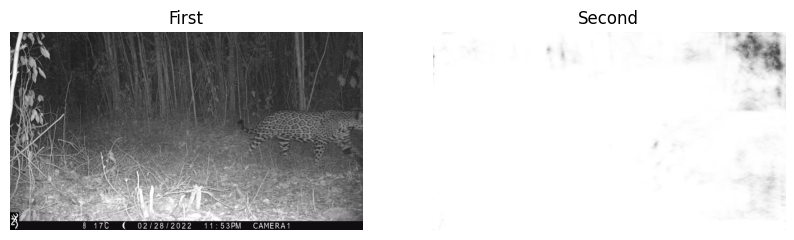

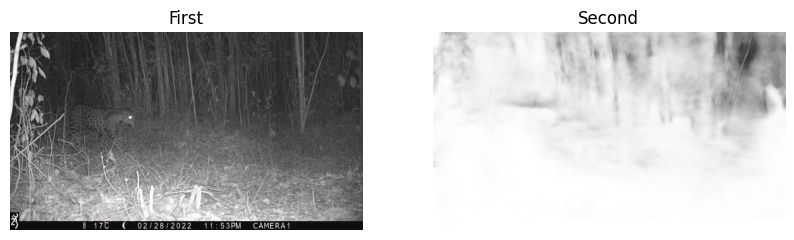

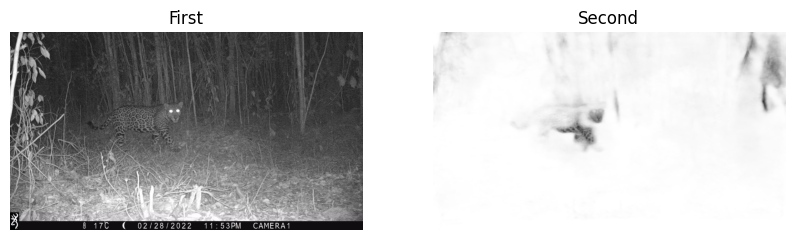

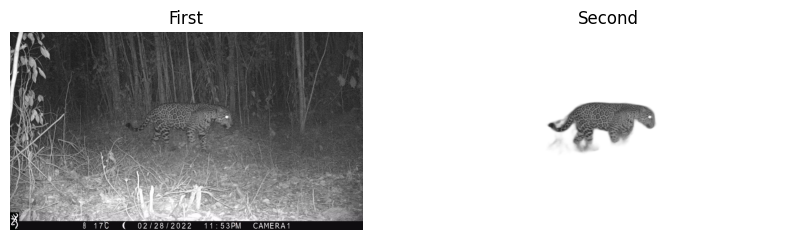

In [49]:
new_path = "frame_rem/"

for im in list(df.query("indv=='frames8'")["img"]):
    # Adds a subplot at the 1st position
    rows = 2
    columns = 2
    fig = plt.figure(figsize=(10, 7))
    input_path = im 
    img  = Image.open(input_path)
    output = remove(img)
    #output.save(new_path+im.replace("frames/",""))
    #save the image without the background
    
    fig.add_subplot(rows, columns, 1)
    # showing image
    plt.imshow(img)
    plt.axis('off')
    plt.title("First")

    # Adds a subplot at the 2nd position
    fig.add_subplot(rows, columns, 2)
    # showing image
    plt.imshow(output)
    plt.axis('off')
    plt.title("Second")
    print(im)

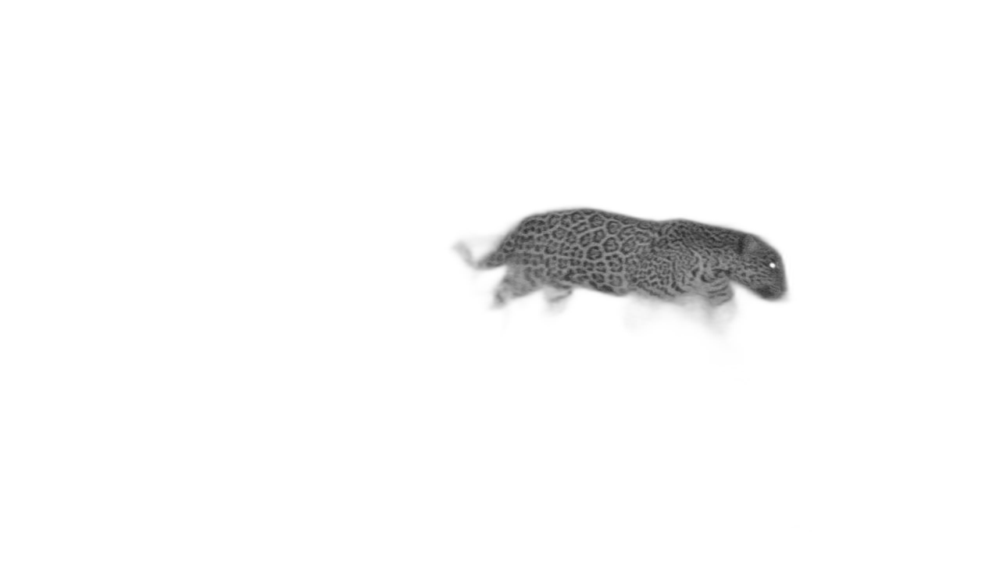

In [34]:
from rembg import remove
from PIL import Image

input_path = list(df.query("indv=='frames8'")["img"])[0]

img  = Image.open(input_path)
output = remove(img)
output.show()

In [64]:
"""
This function takes an img path as input 
and call the function to remove the back_ground
save the imge 
and return the pattern when the image is 
"""
def remove_back(img_p):
   # Adds a subplot at the 1st position
    rows = 2
    columns = 2
    fig = plt.figure(figsize=(10, 7))
    input_path = img_p
    img  = Image.open(input_path)
    output = remove(img)
    output = output.convert('RGB')
    out_path = "back_rem/"+img_p.replace("frames/","").replace("/","_")
    output.save(out_path) 
    
    fig.add_subplot(rows, columns, 1)
    # showing image
    plt.imshow(img)
    plt.axis('off')
    plt.title("First")

    # Adds a subplot at the 2nd position
    fig.add_subplot(rows, columns, 2)
    # showing image
    plt.imshow(output)
    plt.axis('off')
    plt.title("Second") 
    return out_path


/home/ma-user/anaconda3/envs/TensorFlow-2.1/lib/python3.7/site-packages/ipykernel/__main__.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


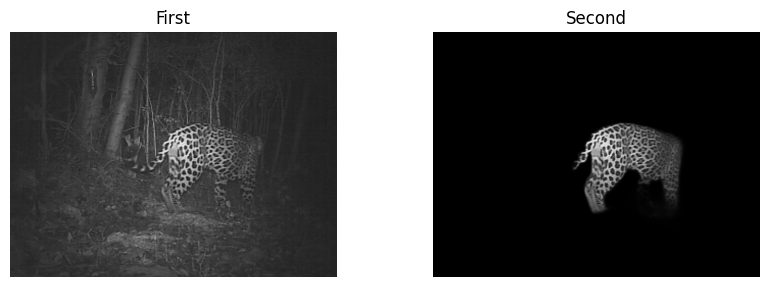

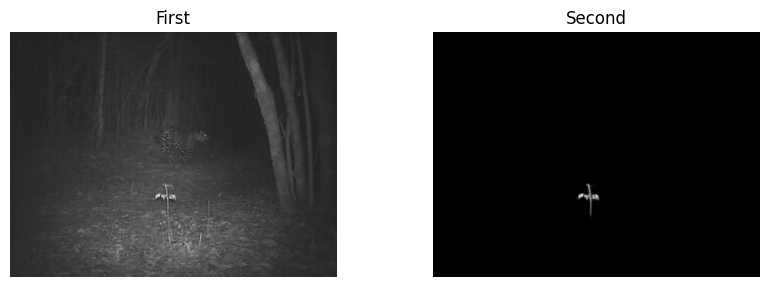

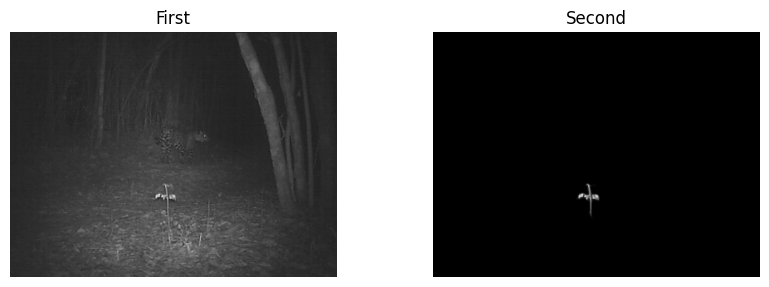

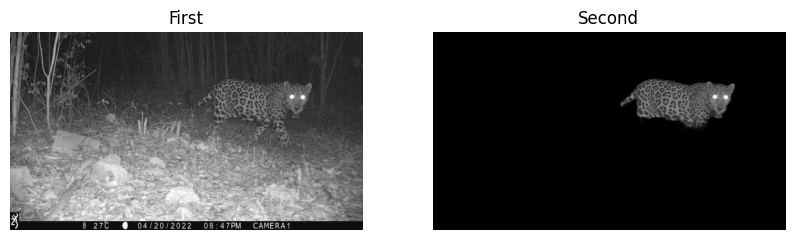

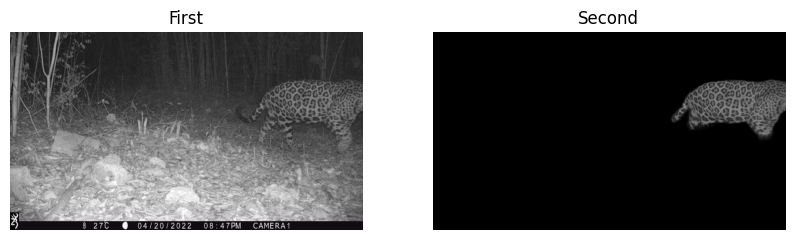

...

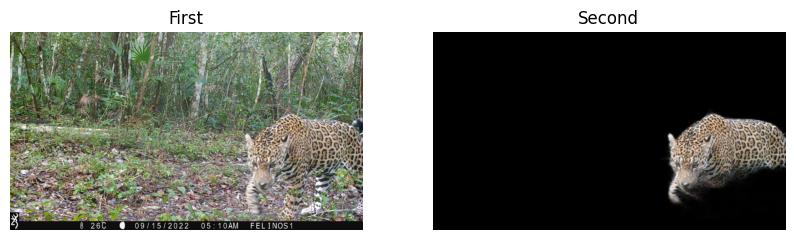

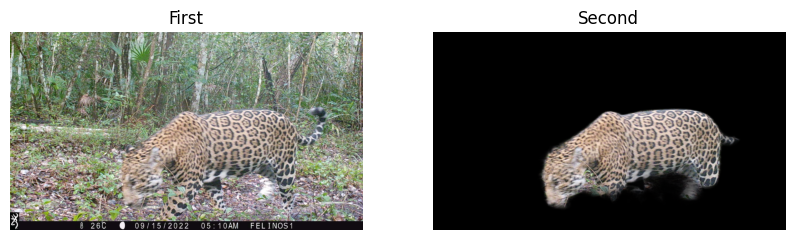

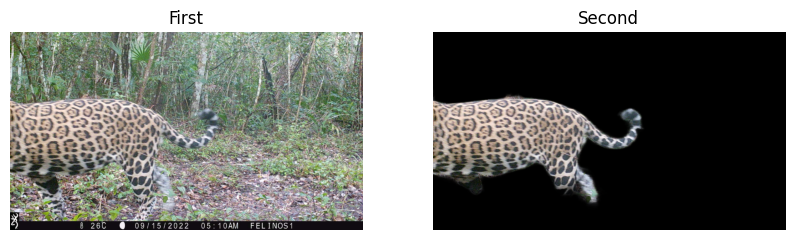

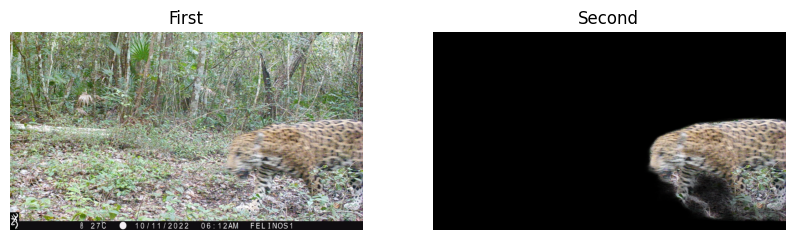

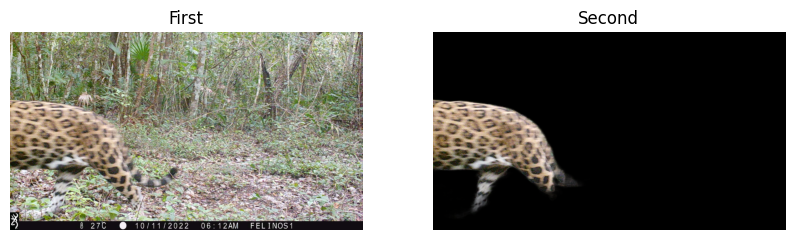

In [65]:
df["rem_back"] = df["img"].apply(remove_back) 

In [126]:
df.to_csv("fm_no_bg.csv")

In [250]:
df

,Unnamed: 0,Unnamed: 0.1,img,video,xmax,ymax,xmin,ymin,label,similarity,indv,rem_back
0,45,45,frames/frames1/30.jpg,frames1,508,432,123,136,Jaguar,28.834324,frames1,back_rem/frames1_30.jpg
1,92,92,frames/frames2/60.jpg,frames2,445,357,236,190,not_jaguar,26.585011,frames2,back_rem/frames2_60.jpg
2,103,103,frames/frames2/90.jpg,frames2,459,350,231,180,not_jaguar,27.067038,frames2,back_rem/frames2_90.jpg
3,127,127,frames/frames4/0.jpg,frames4,944,360,488,114,Jaguar,29.088072,frames4,back_rem/frames4_0.jpg
4,134,134,frames/frames4/30.jpg,frames4,759,392,509,195,not_jaguar,27.595686,frames4,back_rem/frames4_30.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...
96,1013,1013,frames/frames49/0.jpg,frames49,883,597,736,375,not_jaguar,27.236961,frames49,back_rem/frames49_0.jpg
97,1020,1020,frames/frames49/30.jpg,frames49,927,576,665,473,not_jaguar,29.226276,frames49,back_rem/frames49_30.jpg
98,1031,1031,frames/frames49/60.jpg,frames49,624,671,66,378,Jaguar,28.594070,frames49,back_rem/frames49_60.jpg
99,1033,1033,frames/frames50/0.jpg,frames50,903,606,611,484,not_jaguar,26.954906,frames50,back_rem/frames50_0.jpg


# Data Augmentation 

So far we have removed the background from the images 
to be an open source library we have got good results
we have some details in some images. However they are only a few. So we will keep the removed as it is 


Now we have to aumengt the data set with random flips 
to get more data, we are going to make the data augentation 

from both datasets: 

- With background
- Without background


then we have to stack the new to data with the data frame
frames 






In [ ]:
pip install albumentations


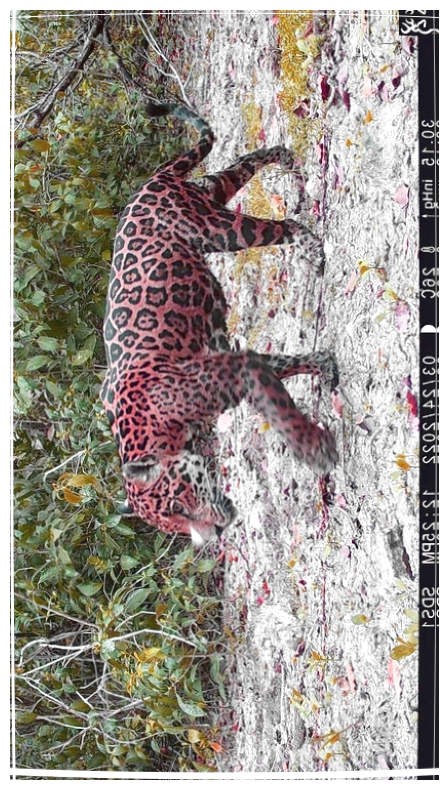

In [80]:
import albumentations as A
import cv2

def visualize(image):
    plt.figure(figsize=(10, 10))
    plt.axis('off')
    plt.imshow(image)

image = cv2.imread('jaguar.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

transform = A.Compose(
    [A.CLAHE(),
     A.RandomRotate90(),
     A.Transpose(),
     A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.50,
                        rotate_limit=45, p=.75),
     A.Blur(blur_limit=3),
     A.OpticalDistortion(),
     A.GridDistortion(),
     A.HueSaturationValue()])

augmented_image = transform(image=image)['image']
visualize(augmented_image)

In [ ]:
!pip install Augmentor


In [125]:
import Augmentor

p = Augmentor.Pipeline("back_rem")
p.rotate(probability=0.7, max_left_rotation=25, max_right_rotation=25)
p.rotate_random_90(probability=0.5)
p.zoom(probability=0.3, min_factor=1.1, max_factor=1.6)
p.skew(probability=0.5)
p.sample(1000)

Initialised with 101 image(s) found.
Output directory set to back_rem/output.

Processing <PIL.Image.Image image mode=RGB size=1280x720 at 0x7F05C5736150>: 100%|██████████| 1000/1000 [00:29<00:00, 34.27 Samples/s]                 


In [127]:
p.status()


Operations: 4
	0: RotateRange (probability=0.7 max_left_rotation=-25 max_right_rotation=25 )
	1: Rotate -1 (probability=0.5 rotation=-1 )
	2: Zoom (probability=0.3 min_factor=1.1 max_factor=1.6 )
	3: Skew (probability=0.5 skew_type=RANDOM magnitude=1 )
Images: 101
Classes: 1
	Class index: 0 Class label: back_rem 
Dimensions: 2
	Width: 1280 Height: 720
	Width: 640 Height: 480
Formats: 1
	 JPEG

You can remove operations using the appropriate index and the remove_operation(index) function.


# count the number of images in the output directory 
import os

# folder path
dir_path = r'back_rem/'
count = 0
names = []
# Iterate directory
for path in os.listdir(dir_path):
    # check if current path is a file
    if os.path.isfile(os.path.join(dir_path, path)):
        count += 1
        names.append(os.path.join(dir_path, path))
print('File count:', count)

In [129]:
# count the number of images in the output directory 
import os

# folder path
dir_path = r'back_rem/output/'
count = 0
names = []
# Iterate directory
for path in os.listdir(dir_path):
    # check if current path is a file
    if os.path.isfile(os.path.join(dir_path, path)):
        count += 1
        names.append(os.path.join(dir_path, path))
print('File count:', count)

File count: 1000


In [130]:
indv_list = [i.split(".jpg")[0].split("_")[-2] for i in names]

In [131]:
df_augmentation = pd.DataFrame({"img":names,"indv":indv_list})
df_augmentation.head()

,img,indv
0,back_rem/output/back_rem_original_frames10_0.j...,frames10
1,back_rem/output/back_rem_original_frames10_0.j...,frames10
2,back_rem/output/back_rem_original_frames10_0.j...,frames10
3,back_rem/output/back_rem_original_frames10_0.j...,frames10
4,back_rem/output/back_rem_original_frames10_0.j...,frames10


In [153]:
df_augmentation.to_csv("augmentation_without_bg.csv")

In [132]:
list(df_augmentation["indv"].unique())

['frames10',
 'frames11',
 'frames14',
 'frames15',
 'frames16',
 'frames17',
 'frames1',
 'frames21',
 'frames23',
 'frames24',
 'frames26',
 'frames27',
 'frames28',
 'frames29',
 'frames2',
 'frames31',
 'frames32',
 'frames33',
 'frames34',
 'frames37',
 'frames38',
 'frames39',
 'frames40',
 'frames42',
 'frames43',
 'frames47',
 'frames48',
 'frames49',
 'frames4',
 'frames50',
 'frames5',
 'frames6',
 'frames7',
 'frames8']

In [133]:
df_augmentation.groupby("indv",sort=False).count()["img"]

indv
frames10    35
frames11    34
frames14    35
frames15    20
frames16    15
frames17    30
frames1     14
frames21    25
frames23    28
frames24    32
frames26    95
frames27    16
frames28    29
frames29    36
frames2     21
frames31    34
frames32    22
frames33    17
frames34    34
frames37    36
frames38    70
frames39    31
frames40    43
frames42     8
frames43     7
frames47    23
frames48    28
frames49    37
frames4     23
frames50    16
frames5     21
frames6     15
frames7     19
frames8     51
Name: img, dtype: int64

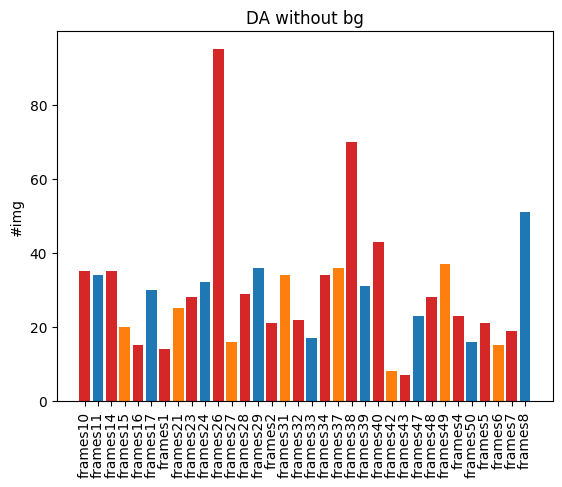

In [164]:
fig, ax = plt.subplots()

#fruits = ['apple', 'blueberry', 'cherry', 'orange']
#counts = [40, 100, 30, 55]
#bar_labels = ['red', 'blue', '_red', 'orange']
#bar_colors = ['tab:red', 'tab:blue', 'tab:red', 'tab:orange']
fruits =list(df_augmentation["indv"].unique())
counts = list(df_augmentation.groupby("indv",sort=False).count()["img"])


ax.bar(fruits, counts, label=bar_labels, color=bar_colors)

ax.set_ylabel('#img')
ax.set_title('DA without bg')
#ax.legend(title='Fruit color')
plt.xticks(rotation = 90) #
plt.show()

In [137]:
df_augmentation.query("indv=='frames1'")

,img,indv
169,back_rem/output/back_rem_original_frames1_30.j...,frames1
170,back_rem/output/back_rem_original_frames1_30.j...,frames1
171,back_rem/output/back_rem_original_frames1_30.j...,frames1
172,back_rem/output/back_rem_original_frames1_30.j...,frames1
173,back_rem/output/back_rem_original_frames1_30.j...,frames1
174,back_rem/output/back_rem_original_frames1_30.j...,frames1
175,back_rem/output/back_rem_original_frames1_30.j...,frames1
176,back_rem/output/back_rem_original_frames1_30.j...,frames1
177,back_rem/output/back_rem_original_frames1_30.j...,frames1
178,back_rem/output/back_rem_original_frames1_30.j...,frames1


In [257]:
pt = list(df.query("indv=='frames1'")["rem_back"])
img  = Image.open()
#output = remove(img)
img.show()

AttributeError: 'int' object has no attribute 'read'

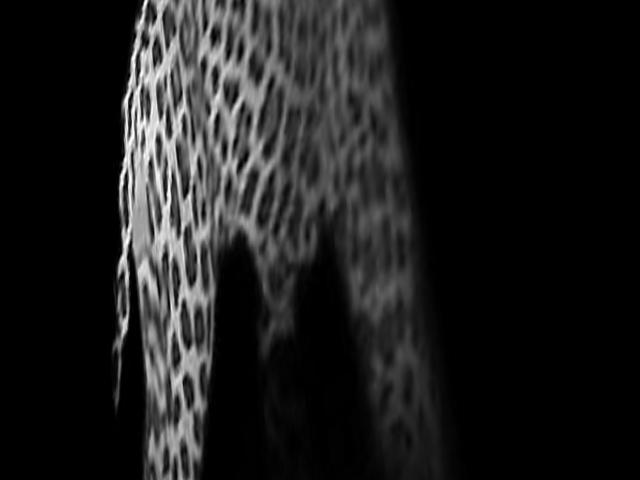

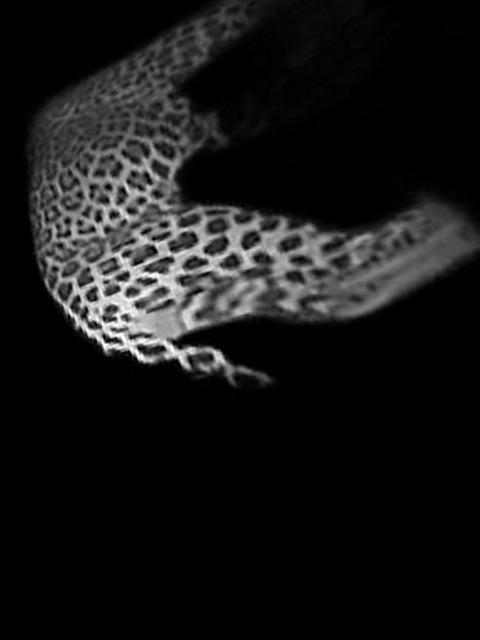

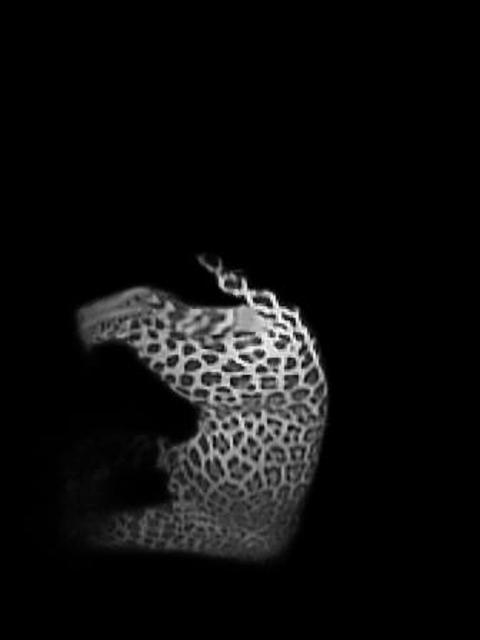

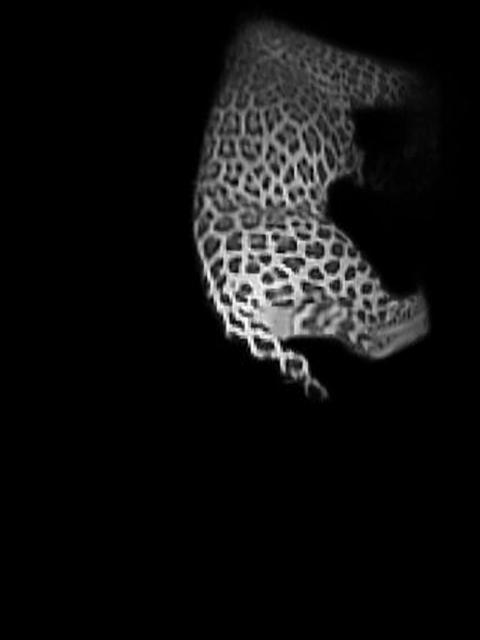

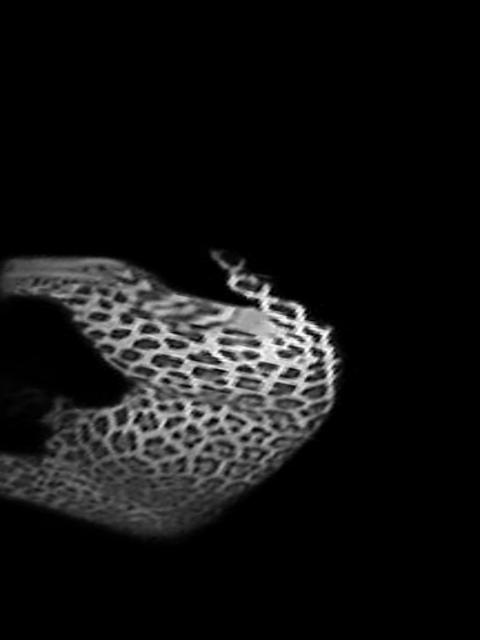

...

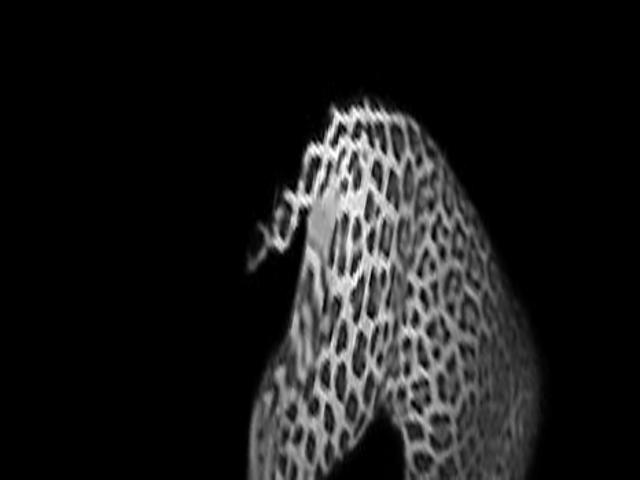

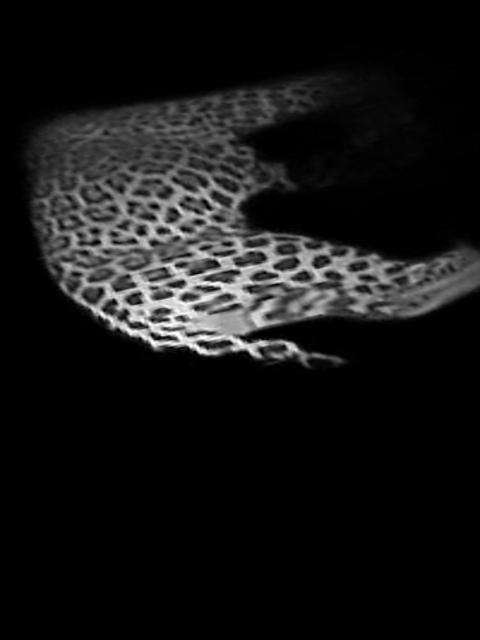

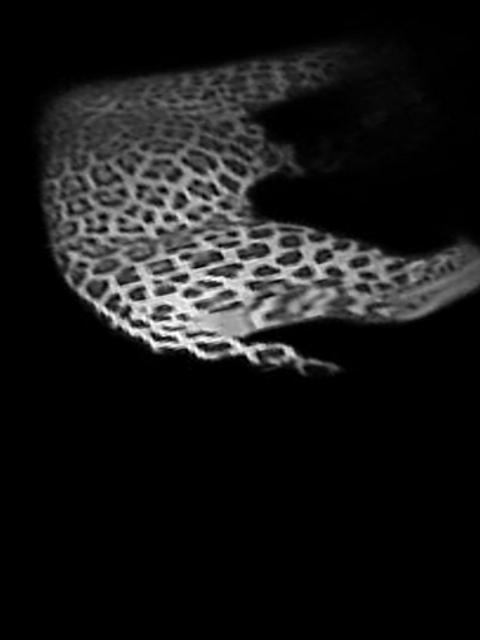

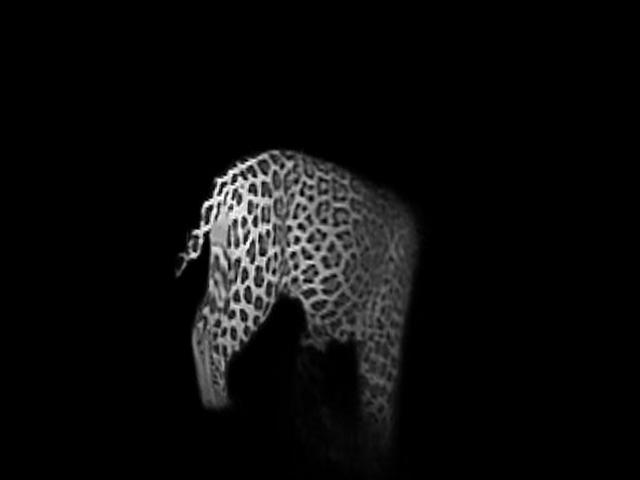

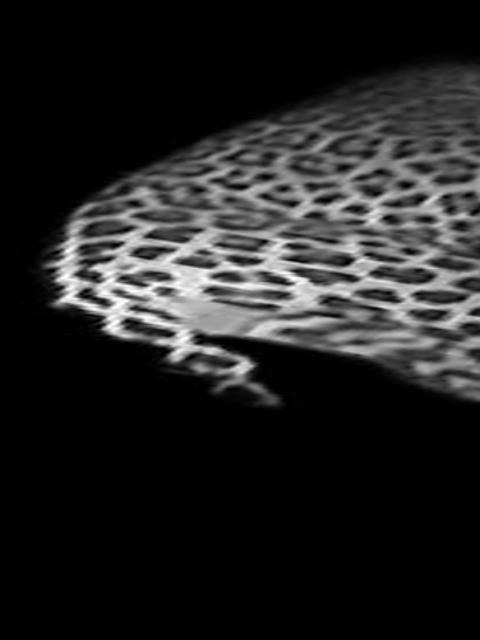

In [138]:
for i in list(df_augmentation.query("indv=='frames1'")["img"]):

    img  = Image.open(i)
    #output = remove(img)
    img.show()

In [140]:
df

,Unnamed: 0,Unnamed: 0.1,img,video,xmax,ymax,xmin,ymin,label,similarity,indv,rem_back
0,45,45,frames/frames1/30.jpg,frames1,508,432,123,136,Jaguar,28.834324,frames1,back_rem/frames1_30.jpg
1,92,92,frames/frames2/60.jpg,frames2,445,357,236,190,not_jaguar,26.585011,frames2,back_rem/frames2_60.jpg
2,103,103,frames/frames2/90.jpg,frames2,459,350,231,180,not_jaguar,27.067038,frames2,back_rem/frames2_90.jpg
3,127,127,frames/frames4/0.jpg,frames4,944,360,488,114,Jaguar,29.088072,frames4,back_rem/frames4_0.jpg
4,134,134,frames/frames4/30.jpg,frames4,759,392,509,195,not_jaguar,27.595686,frames4,back_rem/frames4_30.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...
96,1013,1013,frames/frames49/0.jpg,frames49,883,597,736,375,not_jaguar,27.236961,frames49,back_rem/frames49_0.jpg
97,1020,1020,frames/frames49/30.jpg,frames49,927,576,665,473,not_jaguar,29.226276,frames49,back_rem/frames49_30.jpg
98,1031,1031,frames/frames49/60.jpg,frames49,624,671,66,378,Jaguar,28.594070,frames49,back_rem/frames49_60.jpg
99,1033,1033,frames/frames50/0.jpg,frames50,903,606,611,484,not_jaguar,26.954906,frames50,back_rem/frames50_0.jpg


In [142]:
import shutil
#shutil.copyfile(src, dst)
# 2nd option
shutil.copy("jaguar.jpeg","back_img/frames.jpg") 

'back_img/frames.jpg'

In [147]:
"frames/frames50/60.jpg".split("frames/")[1].replace("/","_")

'frames50_60.jpg'

In [149]:
#copy the files to a single directory 
for i in list(df["img"]):
    #print(i.split("frames/")[1].replace("/","_"))
    shutil.copy(i,"back_img/"+i.split("frames/")[1].replace("/","_")) 

In [151]:
# folder path
dir_path = r'back_img/'
count = 0
# Iterate directory
for path in os.listdir(dir_path):
    # check if current path is a file
    if os.path.isfile(os.path.join(dir_path, path)):
        count += 1
        names.append(os.path.join(dir_path, path))
print('File count:', count)

File count: 101


In [152]:
import Augmentor

p = Augmentor.Pipeline("back_img/")
p.rotate(probability=0.7, max_left_rotation=25, max_right_rotation=25)
p.rotate_random_90(probability=0.5)
p.zoom(probability=0.3, min_factor=1.1, max_factor=1.6)
p.skew(probability=0.5)
p.sample(1000)

Initialised with 101 image(s) found.
Output directory set to back_img/output.

Processing <PIL.Image.Image image mode=RGB size=720x1280 at 0x7F0586072490>: 100%|██████████| 1000/1000 [00:31<00:00, 32.16 Samples/s]                  


In [155]:
p.status()

Operations: 4
	0: RotateRange (probability=0.7 max_left_rotation=-25 max_right_rotation=25 )
	1: Rotate -1 (probability=0.5 rotation=-1 )
	2: Zoom (probability=0.3 min_factor=1.1 max_factor=1.6 )
	3: Skew (probability=0.5 skew_type=RANDOM magnitude=1 )
Images: 101
Classes: 1
	Class index: 0 Class label: back_img 
Dimensions: 2
	Width: 1280 Height: 720
	Width: 640 Height: 480
Formats: 1
	 JPEG

You can remove operations using the appropriate index and the remove_operation(index) function.


In [158]:
# count the number of images in the output directory 
import os

# folder path
dir_path = r'back_img/output/'
count = 0
names = []
# Iterate directory
for path in os.listdir(dir_path):
    # check if current path is a file
    if os.path.isfile(os.path.join(dir_path, path)):
        count += 1
        names.append(os.path.join(dir_path, path))
print('File count:', count)




File count: 1000


In [159]:
indv_list = [i.split(".jpg")[0].split("_")[-2] for i in names]

In [160]:
df_augmentation2 = pd.DataFrame({"img":names,"indv":indv_list})
df_augmentation2.head()

,img,indv
0,back_img/output/back_img_original_frames10_0.j...,frames10
1,back_img/output/back_img_original_frames10_0.j...,frames10
2,back_img/output/back_img_original_frames10_0.j...,frames10
3,back_img/output/back_img_original_frames10_0.j...,frames10
4,back_img/output/back_img_original_frames10_0.j...,frames10


In [223]:
df_augmentation2.to_csv("augmentation_with_bg.csv")

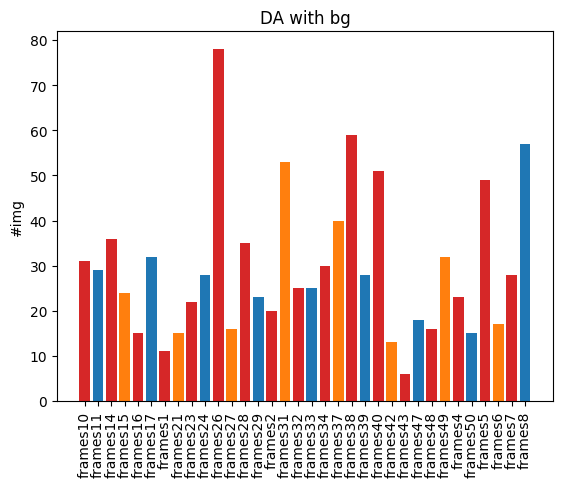

In [163]:
fig, ax = plt.subplots()

#fruits = ['apple', 'blueberry', 'cherry', 'orange']
#counts = [40, 100, 30, 55]
#bar_labels = ['red', 'blue', '_red', 'orange']
#bar_colors = ['tab:red', 'tab:blue', 'tab:red', 'tab:orange']
fruits =list(df_augmentation2["indv"].unique())
counts = list(df_augmentation2.groupby("indv",sort=False).count()["img"])


ax.bar(fruits, counts, label=bar_labels, color=bar_colors)

ax.set_ylabel('#img')
ax.set_title('DA with bg')
#ax.legend(title='Fruit color')
plt.xticks(rotation = 90) #
plt.show()

In [253]:
list(df.query("indv=='frames1'")["img"])

['frames/frames1/30.jpg']

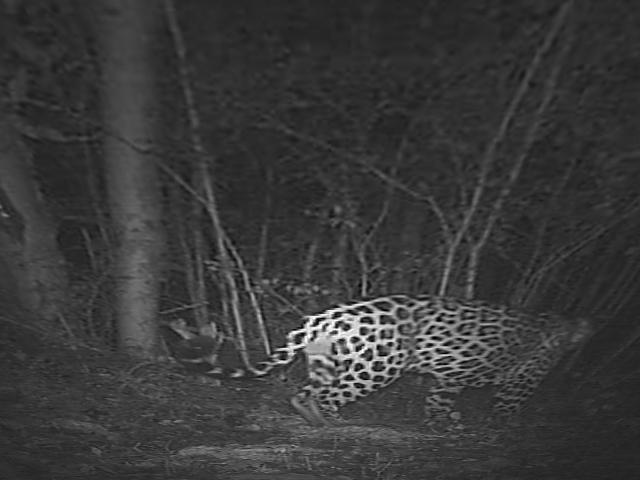

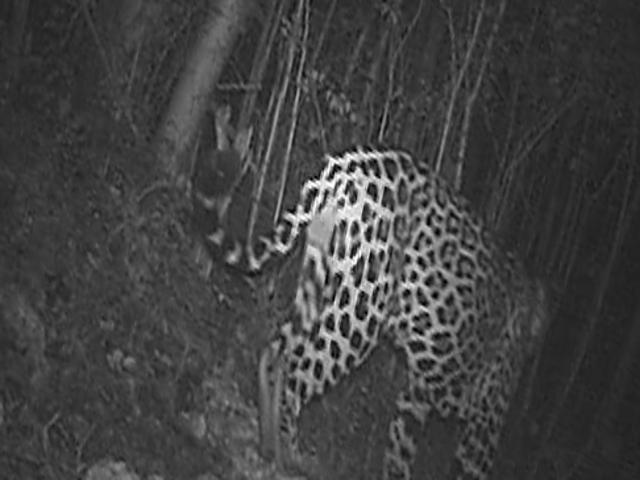

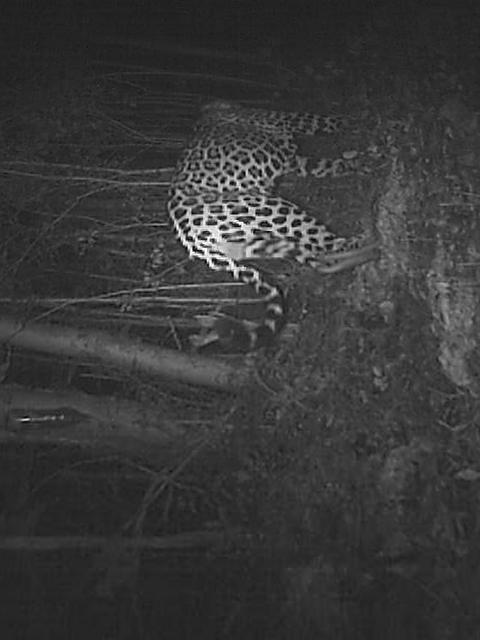

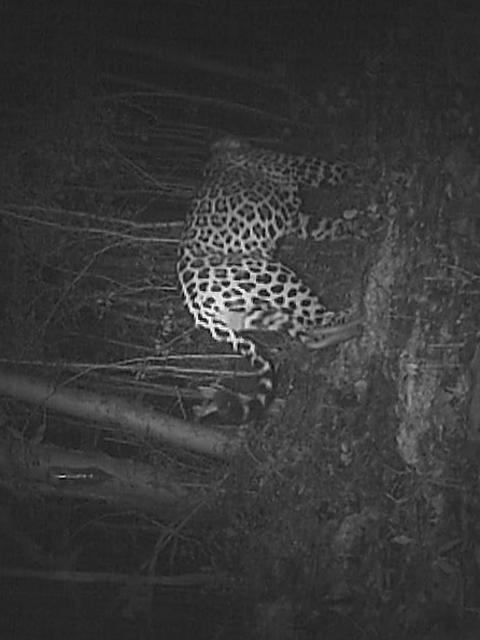

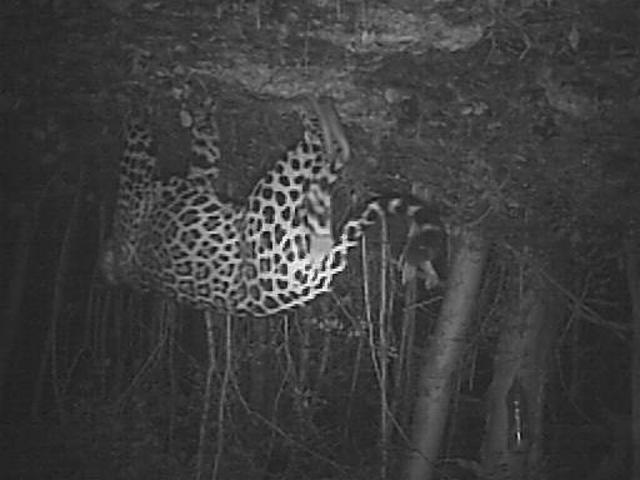

...

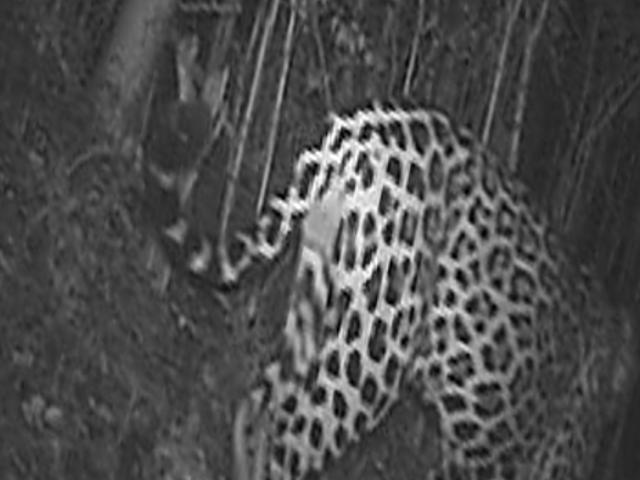

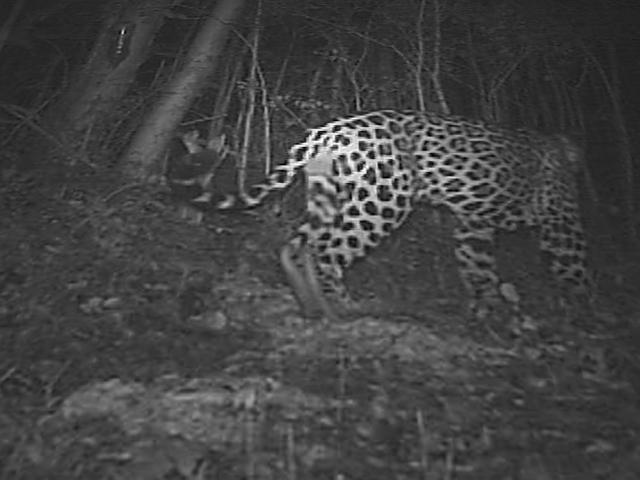

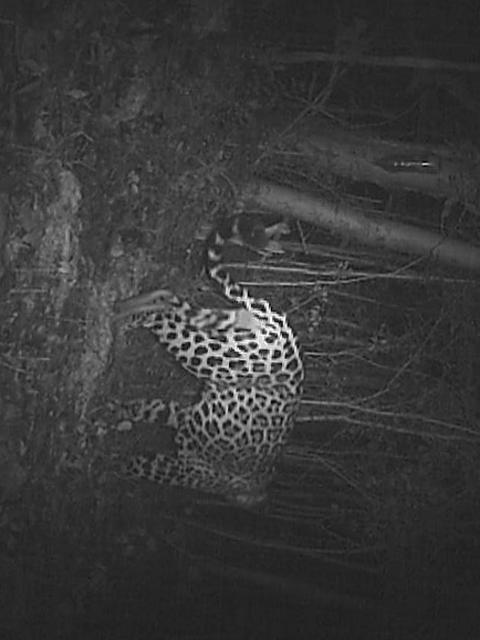

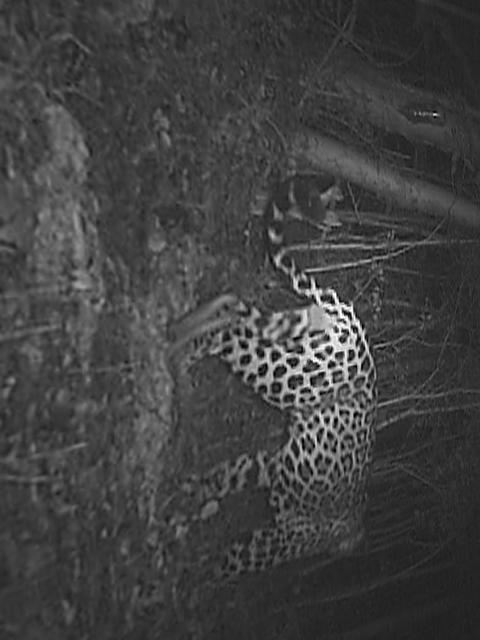

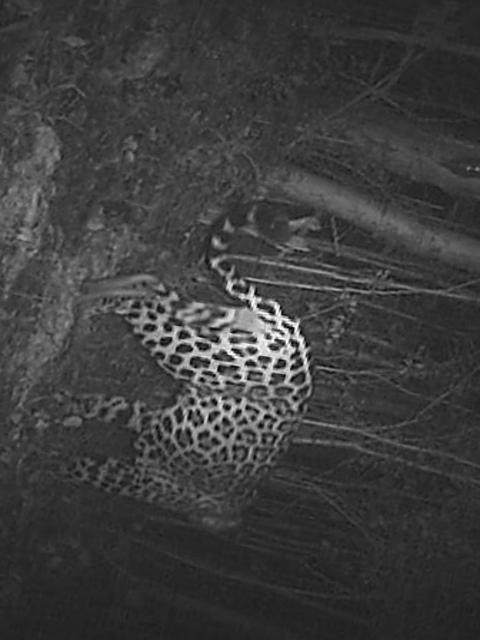

In [166]:
for i in list(df_augmentation2.query("indv=='frames1'")["img"]):

    img  = Image.open(i)
    #output = remove(img)
    img.show()

# Making triplets 


We have augmented the number of images 
per individual. 

Now we need to make the triplets to train the neural, the data should be in the next format. 

(Anchor,Positive,Negative)


In [167]:
#lets work with the image that has no background. 
df_augmentation

,img,indv
0,back_rem/output/back_rem_original_frames10_0.j...,frames10
1,back_rem/output/back_rem_original_frames10_0.j...,frames10
2,back_rem/output/back_rem_original_frames10_0.j...,frames10
3,back_rem/output/back_rem_original_frames10_0.j...,frames10
4,back_rem/output/back_rem_original_frames10_0.j...,frames10
...,...,...
995,back_rem/output/back_rem_original_frames8_90.j...,frames8
996,back_rem/output/back_rem_original_frames8_90.j...,frames8
997,back_rem/output/back_rem_original_frames8_90.j...,frames8
998,back_rem/output/back_rem_original_frames8_90.j...,frames8


In [170]:
import numpy as np

In [178]:
indv_r = len(df_augmentation["indv"].unique())
idx = np.random.randint(indv_r)
idx

32

In [181]:
iter2 = [1,2]
while iter2:
    print("hello")
    iter2.pop()

hello
hello


In [201]:
len(list(df_augmentation.query("indv=='frames1'")["img"]))

14

In [205]:
len(list(df_augmentation.query("indv !='frames1'")["img"]))


986

In [211]:
complement = len(list(df_augmentation.query("indv !='frames1'")["img"]))
random_negative_ids = np.random.randint(complement,size=len(sample_list))


In [213]:
random_neg = [sample_list2[x] for x in random_negative_ids]

In [238]:
from itertools import combinations

triplets_paths = []

#the hole bunch of image is the sample space
#here we call all the images that belong to the set of the given individual. 
sample_list = list(df_augmentation.query("indv=='frames10'")["img"])
list_combinations2 = list()
#we got all the combinations
list_combinations2 += list(combinations(sample_list, 2))
#we call the images which do not belong to indv1
#this is the complement of the universal set 
sample_list2 = list(df_augmentation.query("indv !='frames10'")["img"])
#we calculate the cardinality of the set 
complement = len(list(df_augmentation.query("indv !='frames10'")["img"]))
#we make an array of random int number they are they ids to 
#to call the random negaatives images the size of the array is 
#the length of sample_list2 which the combinations 
random_negative_ids = np.random.randint(complement,size=len(list_combinations2))
#now we have the names of the random_images
random_neg = [sample_list2[x] for x in random_negative_ids]


for i in range(len(list_combinations2)):
    anchor=list_combinations2[i][0]
    positive=list_combinations2[i][1]
    negative=random_neg[i]
    triplets_paths.append([anchor,positive,negative,])



print(len(list_combinations2))

# Returns: [(), ('a',), ('b',), ('c',), ('a', 'b'), ('a', 'c'), ('b', 'c'), ('a', 'b', 'c')]

595


In [ ]:
list(df_augmentation["indv"].unique())

In [ ]:
df_augmentation.query("indv == 'frames10'")

In [244]:
indv_tr = []
num_tr = []

for ind in list(df_augmentation["indv"].unique()):
    #df_augmentation.query("indv== '{}'".format(ind))
    #n = len(list(df_augmentation.query("indv=='{}'".format(ind))["img"]))
    #c = len(list(df_augmentation.query("indv!='{}'".format(ind))["img"]))
    #print("ind: {}, Cardinality: {}, complement: {}".format(ind,n,c))
    indv_tr.append(ind)
    sample_list = list(df_augmentation.query("indv=='{}'".format(ind))["img"])
    list_combinations2 = list()
    #we got all the combinations
    list_combinations2 += list(combinations(sample_list, 2))
    num_tr.append(len(list_combinations2))
    
    

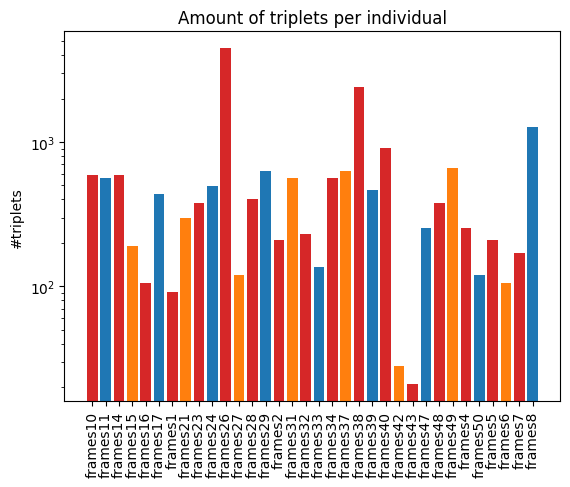

In [246]:
fig, ax = plt.subplots()

#fruits = ['apple', 'blueberry', 'cherry', 'orange']
#counts = [40, 100, 30, 55]
#bar_labels = ['red', 'blue', '_red', 'orange']
#bar_colors = ['tab:red', 'tab:blue', 'tab:red', 'tab:orange']
fruits = indv_tr
counts = num_tr


ax.bar(fruits, counts, label=bar_labels, color=bar_colors)

ax.set_ylabel('#triplets')
ax.set_title('Amount of triplets per individual')
ax.set_yscale('log')

#ax.legend(title='Fruit color')
plt.xticks(rotation = 90) #
plt.show()

In [243]:
#lets iterate over the hole dataset 
data3 = {"anchor":[],"positive":[],"negative":[]}


for ind in list(df_augmentation["indv"].unique()):
    triplets_paths = []

    #the hole bunch of image is the sample space
    #here we call all the images that belong to the set of the given individual. 
    sample_list = list(df_augmentation.query("indv=='{}'".format(ind))["img"])
    list_combinations2 = list()
    #we got all the combinations
    list_combinations2 += list(combinations(sample_list, 2))
    #we call the images which do not belong to indv1
    #this is the complement of the universal set 
    sample_list2 = list(df_augmentation.query("indv !='{}'".format(ind))["img"])
    #we calculate the cardinality of the set 
    complement = len(list(df_augmentation.query("indv !='{}'".format(ind))["img"]))
    #we make an array of random int number they are they ids to 
    #to call the random negaatives images the size of the array is 
    #the length of sample_list2 which the combinations 
    random_negative_ids = np.random.randint(complement,size=len(list_combinations2))
    #now we have the names of the random_images
    random_neg = [sample_list2[x] for x in random_negative_ids]


    for i in range(len(list_combinations2)):
        data3["anchor"].append(list_combinations2[i][0])
        data3["positive"].append(list_combinations2[i][1])
        data3["negative"].append(random_neg[i])
    
    
df_triplets = pd.DataFrame(data3)
df_triplets

,anchor,positive,negative
0,back_rem/output/back_rem_original_frames10_0.j...,back_rem/output/back_rem_original_frames10_0.j...,back_rem/output/back_rem_original_frames29_90....
1,back_rem/output/back_rem_original_frames10_0.j...,back_rem/output/back_rem_original_frames10_0.j...,back_rem/output/back_rem_original_frames5_90.j...
2,back_rem/output/back_rem_original_frames10_0.j...,back_rem/output/back_rem_original_frames10_0.j...,back_rem/output/back_rem_original_frames40_30....
3,back_rem/output/back_rem_original_frames10_0.j...,back_rem/output/back_rem_original_frames10_0.j...,back_rem/output/back_rem_original_frames24_60....
4,back_rem/output/back_rem_original_frames10_0.j...,back_rem/output/back_rem_original_frames10_0.j...,back_rem/output/back_rem_original_frames48_0.j...
...,...,...,...
18954,back_rem/output/back_rem_original_frames8_90.j...,back_rem/output/back_rem_original_frames8_90.j...,back_rem/output/back_rem_original_frames26_240...
18955,back_rem/output/back_rem_original_frames8_90.j...,back_rem/output/back_rem_original_frames8_90.j...,back_rem/output/back_rem_original_frames38_120...
18956,back_rem/output/back_rem_original_frames8_90.j...,back_rem/output/back_rem_original_frames8_90.j...,back_rem/output/back_rem_original_frames11_60....
18957,back_rem/output/back_rem_original_frames8_90.j...,back_rem/output/back_rem_original_frames8_90.j...,back_rem/output/back_rem_original_frames40_30....


In [248]:
df_triplets.to_csv("triplets_remvb.csv")

In [222]:
triplets_paths[2]

['back_rem/output/back_rem_original_frames1_30.jpg_0915a0fb-951c-486d-929a-2650ee4876c5.jpg',
 'back_rem/output/back_rem_original_frames1_30.jpg_3bd2b4f7-43db-404f-8bc5-8926156cd193.jpg',
 'back_rem/output/back_rem_original_frames26_150.jpg_89bd5c2a-e6e4-448c-bb8d-bdb11b36d18e.jpg']

In [216]:
print(len(random_neg))


91


In [214]:
list_combinations2[-2][0]

'back_rem/output/back_rem_original_frames1_30.jpg_da81c168-9818-41b4-832e-8ad70cfa7c5c.jpg'

In [217]:
for i in range(len(list_combinations2)):
    anchor=list_combinations2[i][0]
    positive=list_combinations2[i][1]
    negative=random_neg[i]
    